Amount of sources with a separation of 3.0 arcsec: 209
mkdir: cannot create directory ‘cutout_mk’: File exists
mkdir: cannot create directory ‘image_overlay’: File exists
cp: cannot stat './output_folder/*': No such file or directory
Processing KiDSDR4 J224328.445-305645.80  at RA: 340.8684033190276 deg, DEC: -30.946050856792 deg
INFO: Auto-setting vmin to -1.300e+01 [aplpy.core]
INFO: Auto-setting vmax to  1.564e+02 [aplpy.core]
Processing KiDSDR4 J224321.790-294611.26  at RA: 340.84056220822185 deg, DEC: -29.769958148952842 deg
INFO: Auto-setting vmin to -1.570e+01 [aplpy.core]
INFO: Auto-setting vmax to  1.864e+02 [aplpy.core]
Processing KiDSDR4 J224240.883-290427.51  at RA: 340.669959979649 deg, DEC: -29.074276401537876 deg
INFO: Auto-setting vmin to -1.340e+01 [aplpy.core]
INFO: Auto-setting vmax to  1.608e+02 [aplpy.core]
Processing KiDSDR4 J224228.039-275121.85  at RA: 340.61636669279335 deg, DEC: -27.856204268804984 deg
INFO: Auto-setting vmin to -8.400e+00 [aplpy.core]
INFO: A

/users/mshabalala/srl2/functions.py:305: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(8, 8))


INFO: Auto-setting vmin to -1.490e+01 [aplpy.core]
INFO: Auto-setting vmax to  1.775e+02 [aplpy.core]
Processing KiDSDR4 J224022.547-294130.38  at RA: 340.0937872022329 deg, DEC: -29.691845162284533 deg
INFO: Auto-setting vmin to -1.120e+01 [aplpy.core]
INFO: Auto-setting vmax to  1.364e+02 [aplpy.core]
Processing KiDSDR4 J224004.666-281216.20  at RA: 340.01952942543056 deg, DEC: -28.2046967091707 deg
INFO: Auto-setting vmin to -1.270e+01 [aplpy.core]
INFO: Auto-setting vmax to  1.531e+02 [aplpy.core]
Processing KiDSDR4 J224006.447-294047.90  at RA: 340.0261400562127 deg, DEC: -29.679870331443826 deg
INFO: Auto-setting vmin to -1.110e+01 [aplpy.core]
INFO: Auto-setting vmax to  1.353e+02 [aplpy.core]
Processing KiDSDR4 J224000.236-293215.29  at RA: 340.0007468885628 deg, DEC: -29.53760604127621 deg
INFO: Auto-setting vmin to -1.050e+01 [aplpy.core]
INFO: Auto-setting vmax to  1.287e+02 [aplpy.core]
Processing KiDSDR4 J223925.463-284426.04  at RA: 339.85609079853435 deg, DEC: -28.740725

FileNotFoundError: [Errno 2] No such file or directory: 'cutout_mk/KiDSDR4 J223246.698-283547.19 .fits'

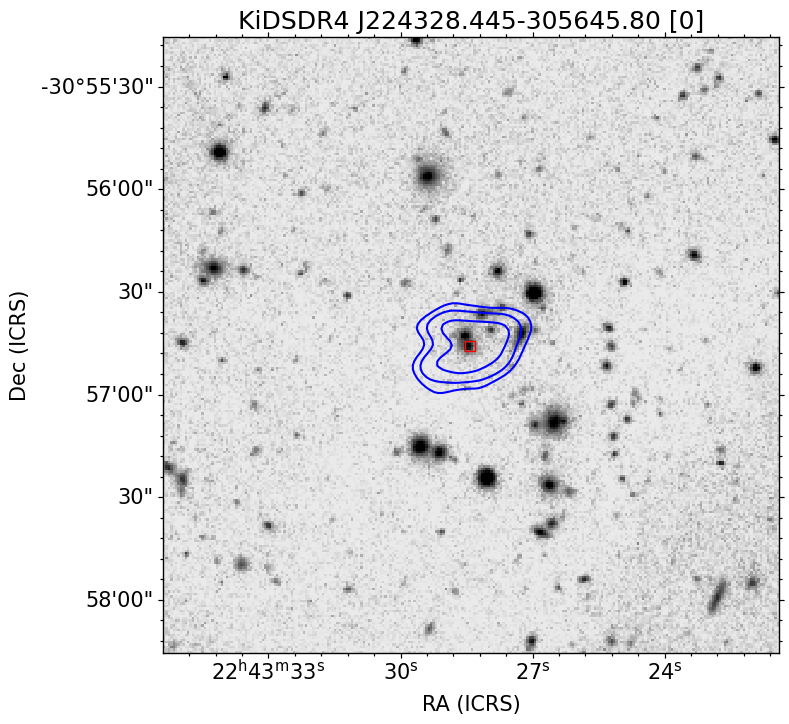

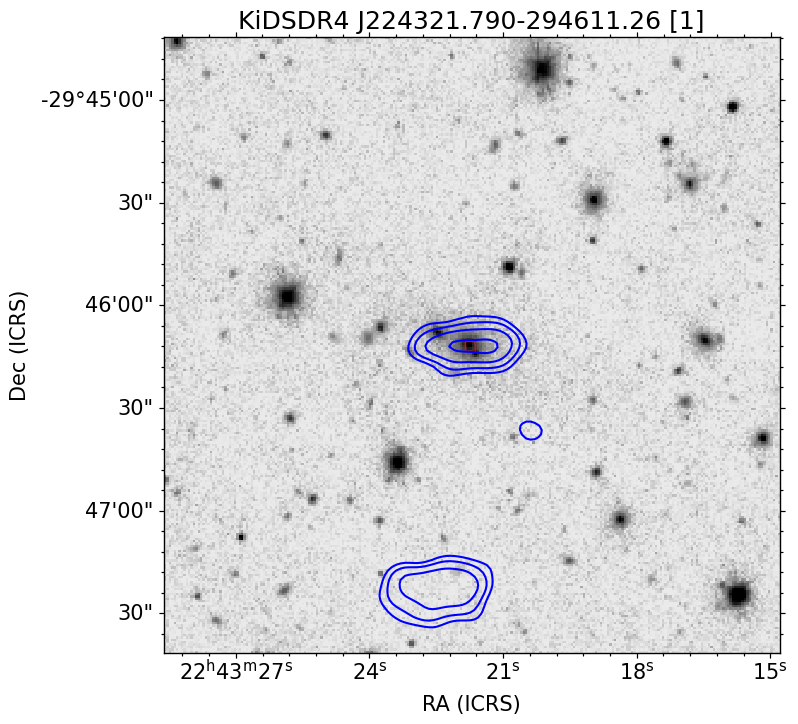

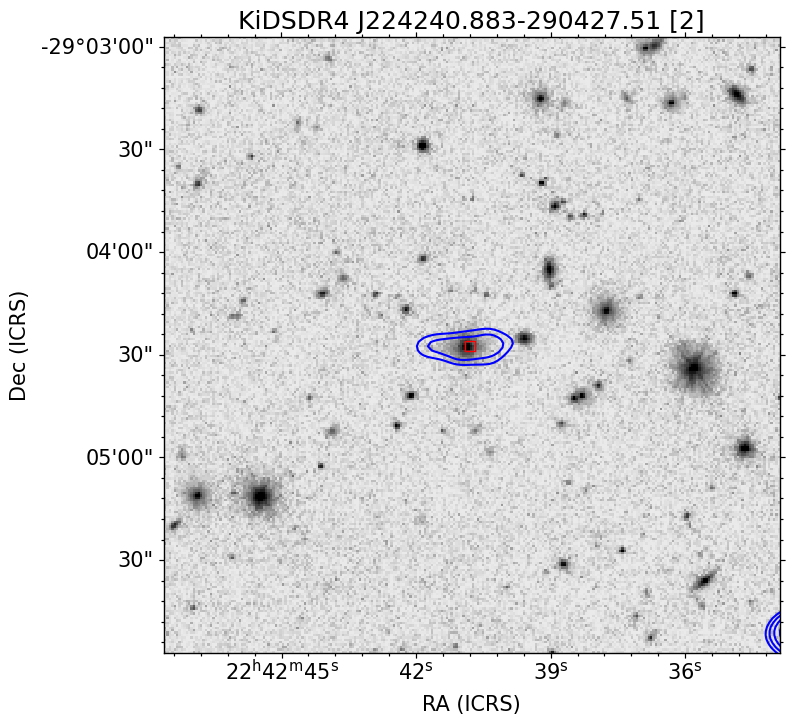

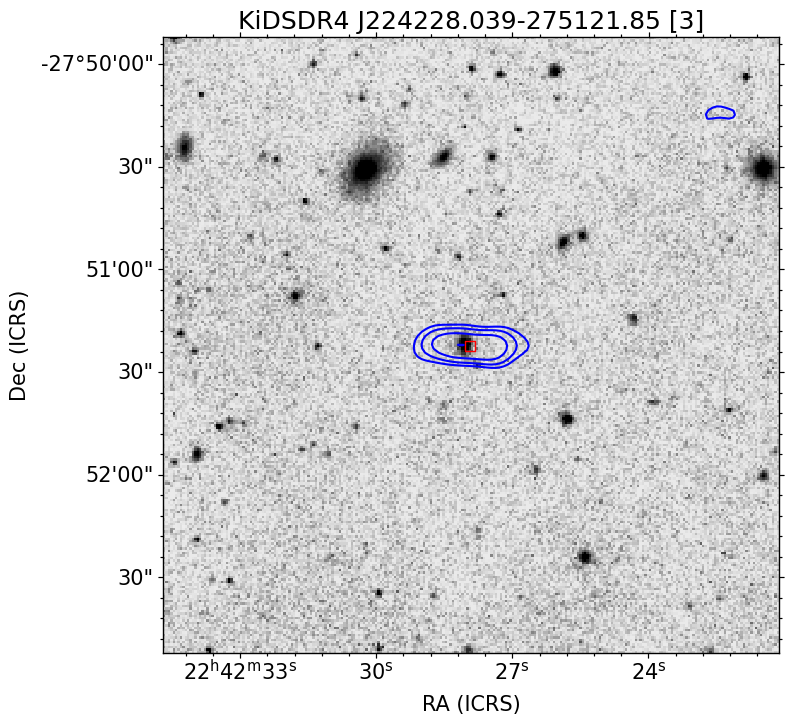

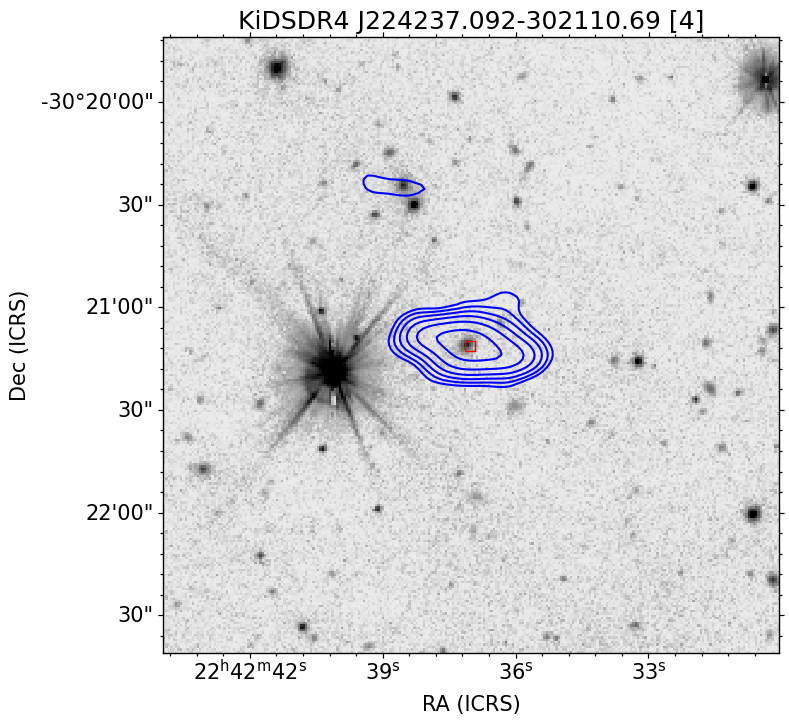

...

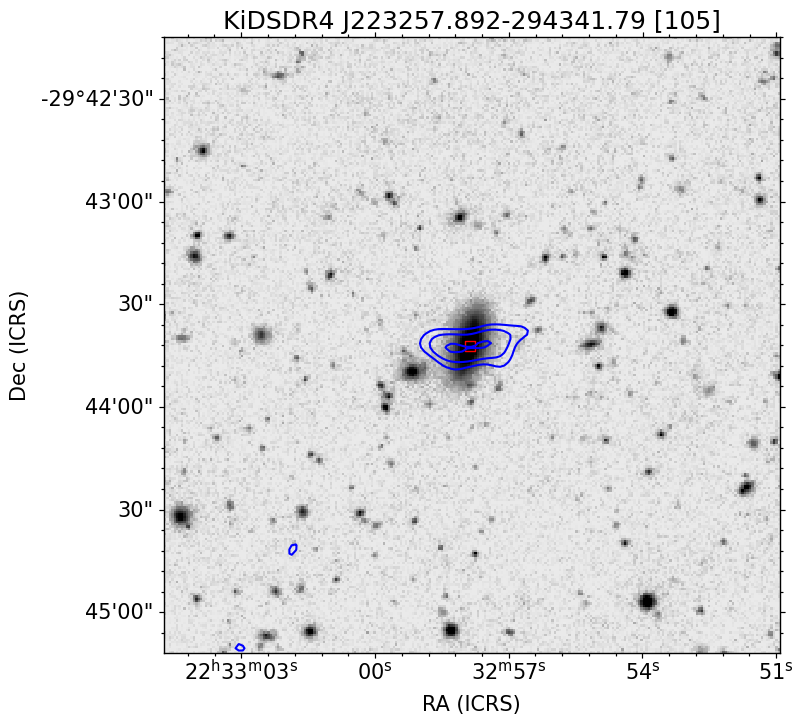

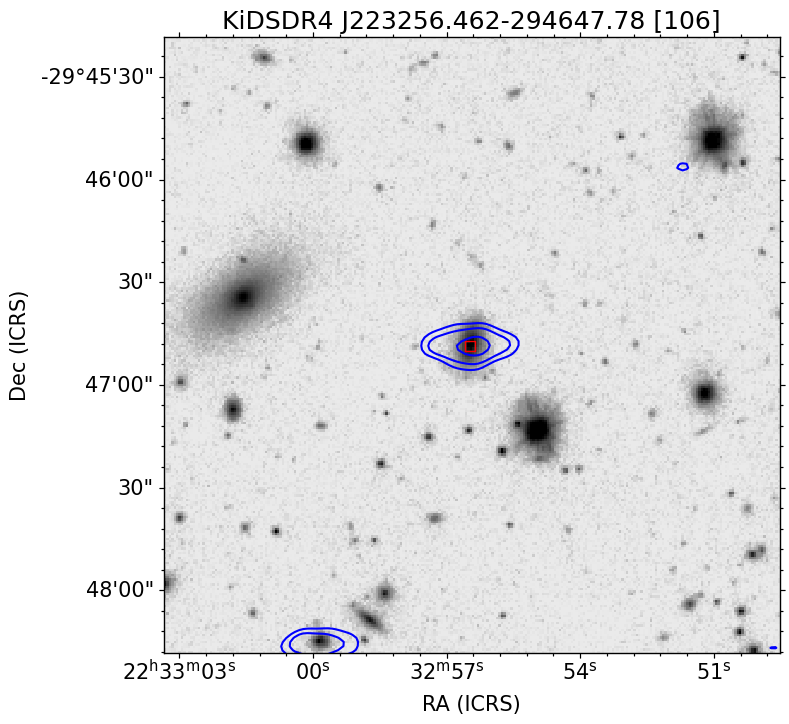

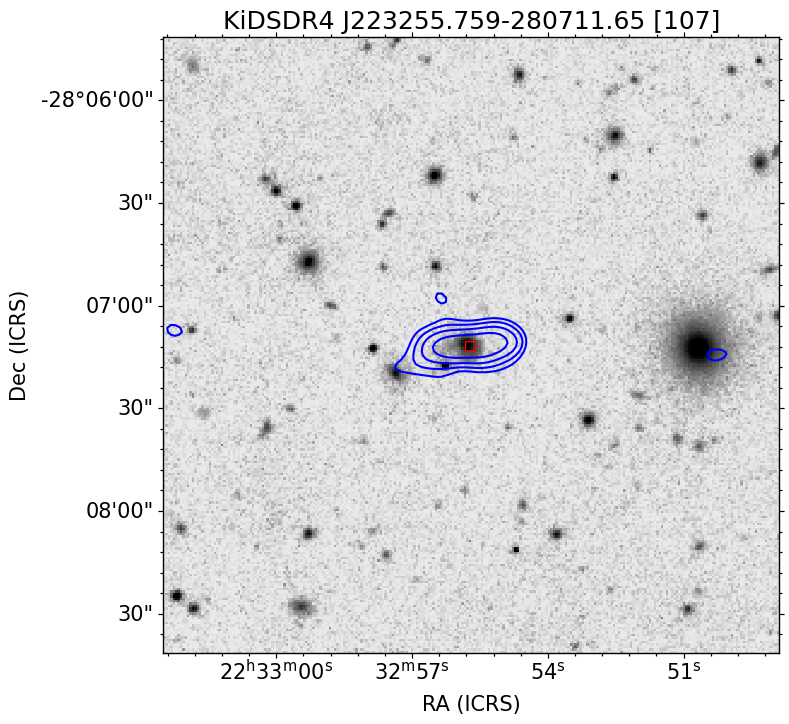

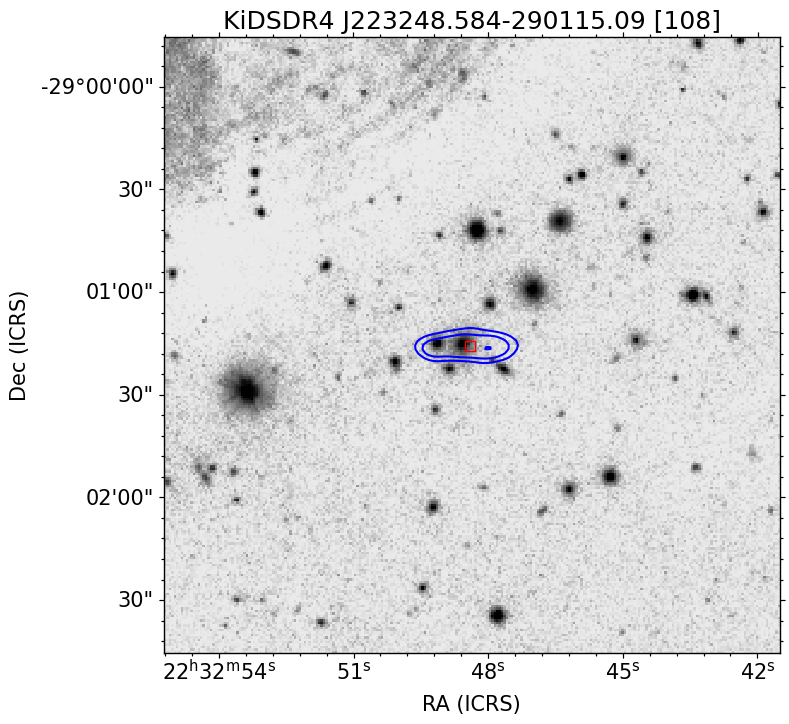

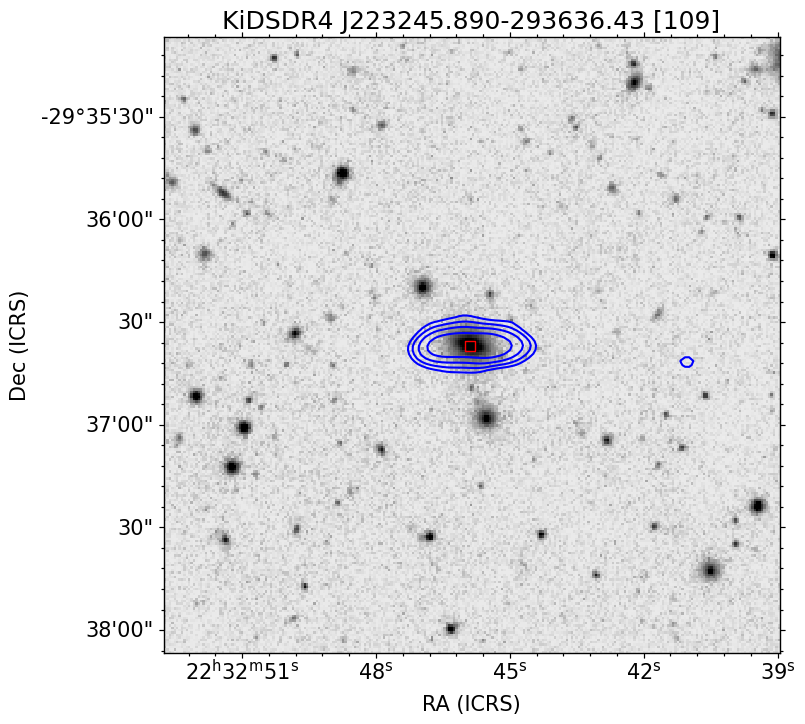

In [1]:
import os
import numpy as np
import pandas as pd
import configparser
import matplotlib.pyplot as plt
from matplotlib.colors import Colormap
import aplpy

from astropy.io import fits
from astropy.wcs import WCS
from astropy import units as u
from astropy.coordinates import SkyCoord, Longitude, Latitude, Angle

from astroquery.vizier import Vizier
from astroquery.hips2fits import hips2fits

from functions import *  # Import your custom functions



def load_config(config_file='parameter.ini'):
    """
    #Load parameters from the .ini file.
    """
    config = configparser.ConfigParser()
    config.read(config_file)
    return config
# Load the configuration
config = load_config()
# File inputs and relevent qualities
kids_fits = config['kiDS']['fits_data']
meerkat_fits = config['meerKAT']['fits_data']
meerklass_image = config['FITSFile']['input_fits']
#separation_threshold =float( config['General']['separation_threshold'])
separation_threshold = 3/3600
output_file1 = config['output']['file1']
# Load data
kids_df = load_fits_data(kids_fits)
df_mk = load_fits_data(meerkat_fits)

# Filter KiDS data
fil_df = filter_kids_by_fits(kids_df, meerklass_image)
closest_matches_df = find_and_filter_matches(fil_df, df_mk,separation_threshold, output_file1= 'closest_matches_df1.txt')


def load_config(config_file='parameter.ini'):
    """
    #Load parameters from the .ini file.
    """
    config = configparser.ConfigParser()
    config.read(config_file)
    return config


def process_fits_cutout(config):
    """
    #Process the FITS cutouts from the configuration and save them.
    """
    # Load parameters from the .ini file
    fits_file = 'D01-05_LOC22_im-di2_smallFacet.deeper.DI.int.restored.fits'
    #fits_file = config['FITSFile']['input_fits']#the mosaic image
    coord_file = config['Coordinates']['coord_file']
    output_folder = config['FITSFile']['output_folder']
    xw = int(config['Cutout']['xw'])
    yw = int(config['Cutout']['yw'])
    units = config['Cutout']['units']
    clobber = config.getboolean('Cutout', 'clobber')

    # Load FITS data and coordinates
    fits_data = fits.getdata(fits_file, 0)
    header = fits.getheader(fits_file)
    image_data = fits_data[0][0]
    #fits_data, header, image_data = load_fits_data(fits_file)
    
     #Load and Convert the coordinates from the MeerKLASS catalog into pixels.
    ID, RA, Dec, c, pixel_x, pixel_y = load_and_convert_coordinates(coord_file, header)
    
    # Create cutout
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    cutout(fits_file, xc=pixel_x, yc=pixel_y, name=ID, xw=xw, yw=yw, units=units, JPEGFolder=output_folder, clobber=clobber)

def process_hips_data(config):
    """
    #Process the HIPS catalog data for the given targets and save results.
    """
    hips_catalog = config['General']['hips_catalog']
    output_dir = config['General']['output_dir']
    input_file = config['General']['input_file']
    fov = float(config['General']['fov'])
    width = int(config['General']['width'])
    height = int(config['General']['height'])
    output_folder = config['FITSFile']['output_folder']

    mkcat = np.genfromtxt('closest_matches_df1.txt', 
                      delimiter=',',      # Adjust the delimiter if necessary
                      dtype=None,        # Allow mixed data types
                      encoding=None,     # Use 'utf-8' or None depending on your data
                      names=True)        # Load column names as field names
    !mkdir cutout_mk
    !mkdir image_overlay
    !cp -r ./output_folder/* cutout_mk
    
    # Process each target
    for ii in range(mkcat.shape[0]):
        target_name = str(mkcat['ID'][ii])
        target_RA = mkcat['MK_RA'][ii] * u.deg
        target_DEC = mkcat['MK_DEC'][ii] * u.deg
        print(f"Processing {target_name} at RA: {target_RA}, DEC: {target_DEC}")

        #hips = 'CDS/P/KiDS/DR5/color-gri'
        # Download the optical cutout from the HIPS catalog
        result = download_cutout(target_RA, target_DEC, hips_catalog, fov=fov, width=width, height=height)
        #extract the coordinates of the closest meatches
        df_clo = pd.read_csv('closest_matches_df1.txt', delimiter=',')
        # Extract the RA and DEC for the closest matches
        xG = df_clo['RAJ2000'][ii]*u.deg
        yG = df_clo['DECJ2000'][ii]*u.deg

        fitsfile = f'cutout_mk/{target_name}.fits'
        clean_fits_header(fitsfile)
        
        HF_levels = compute_contour_levels(fitsfile)
        create_overlay_image(target_name, result, fitsfile, xG, yG, HF_levels, ii)
        
def main():
   # Load parameters from the .ini file
    config = load_config()

    # Run the different processing functions
    process_fits_cutout(config)
    process_hips_data(config)

if __name__ == '__main__':
    main()


In [1]:

import os
from astroquery.hips2fits import hips2fits
import matplotlib.pyplot as plt
from matplotlib.colors import Colormap
import astropy.units as u
from astropy.coordinates import Longitude, Latitude, Angle
from astropy.wcs import WCS
from astropy.io import fits
import numpy as np
from astroquery.vizier import Vizier
from astropy.coordinates import SkyCoord
import pandas as pd
import aplpy
import pandas as pd
import numpy as np
from astropy.io import fits
import configparser
#from astroquery.hips import hips2fits
from astroquery.vizier import Vizier
from astropy import units as u
from functions import *
#load_fits_data,load_and_convert_coordinates, cutout


def load_config(config_file='parameter.ini'):
    """
    #Load parameters from the .ini file.
    """
    config = configparser.ConfigParser()
    config.read(config_file)
    return config


def process_fits_cutout(config):
    """
    #Process the FITS cutouts from the configuration and save them.
    """
    # Load parameters from the .ini file
    fits_file = 'D01-05_LOC22_im-di2_smallFacet.deeper.DI.int.restored.fits'
    #fits_file = config['FITSFile']['input_fits']#the mosaic image
    coord_file = config['Coordinates']['coord_file']
    output_folder = config['FITSFile']['output_folder']
    xw = int(config['Cutout']['xw'])
    yw = int(config['Cutout']['yw'])
    units = config['Cutout']['units']
    clobber = config.getboolean('Cutout', 'clobber')

    # Load FITS data and coordinates
    fits_data = fits.getdata(fits_file, 0)
    header = fits.getheader(fits_file)
    image_data = fits_data[0][0]
    #fits_data, header, image_data = load_fits_data(fits_file)
    
     #Load and Convert the coordinates from the MeerKLASS catalog into pixels.
    ID, RA, Dec, c, pixel_x, pixel_y = load_and_convert_coordinates(coord_file, header)
    #ID, RA, Dec, c = load_coordinates(coord_file)

    # Get pixel coordinates
    #pixel_x, pixel_y = get_pixel_coordinates(c, header)

    # Create cutout
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    cutout(fits_file, xc=pixel_x, yc=pixel_y, name=ID, xw=xw, yw=yw, units=units, JPEGFolder=output_folder, clobber=clobber)


def main():
   # Load parameters from the .ini file
    config = load_config()

    # Run the different processing functions
    #process_kids_meerkat_data(config)
    process_fits_cutout(config)
 #   process_hips_data(config)

if __name__ == '__main__':
    main()
